**Library**

In [3]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as pltimg

from sklearn.metrics import confusion_matrix, classification_report, accuracy_score 
from sklearn.metrics import mean_squared_error, r2_score, make_scorer
from sklearn import tree
from sklearn.tree import plot_tree
from sklearn.tree import DecisionTreeClassifier, DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingClassifier, GradientBoostingRegressor
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.model_selection import GridSearchCV

from sklearn.preprocessing import LabelEncoder

**Dataset**

In [4]:
Nike = pd.read_csv("nike_data_13-09-2023.csv")

missing_values = Nike.isnull().sum()
for i in range(Nike.shape[1]):
    if missing_values[i] != 0:
        print("Missing Values:", missing_values.index[i], missing_values[i])
        
Nike = Nike.drop(columns = ["Username", "Review", "isLaunch"], axis = 1)
Nike["Location"].fillna("Unknown", inplace = True)
Nike["Fit Feedback"].fillna("Unknown", inplace = True)
Nike["Comfort Feedback"].fillna("Unknown", inplace = True)
Nike["Recommend Feedback"].fillna("Unknown", inplace = True)

Nike = Nike.dropna().reset_index(drop = True)

Missing Values: Rating 37
Missing Values: Review Date 37
Missing Values: Location 1576
Missing Values: Username 37
Missing Values: Fit Feedback 4180
Missing Values: Comfort Feedback 4180
Missing Values: Recommend Feedback 4180


**EDA**

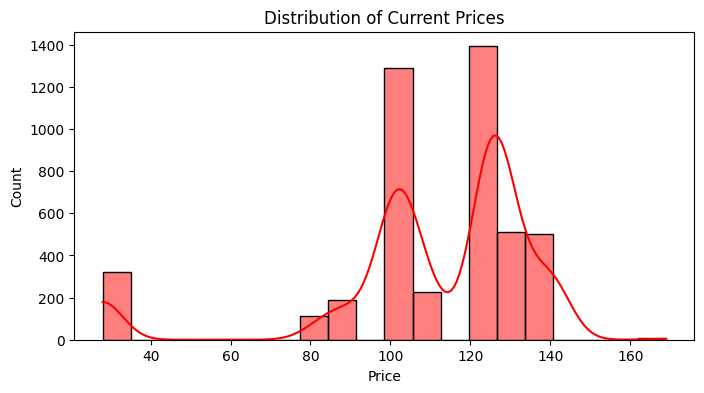

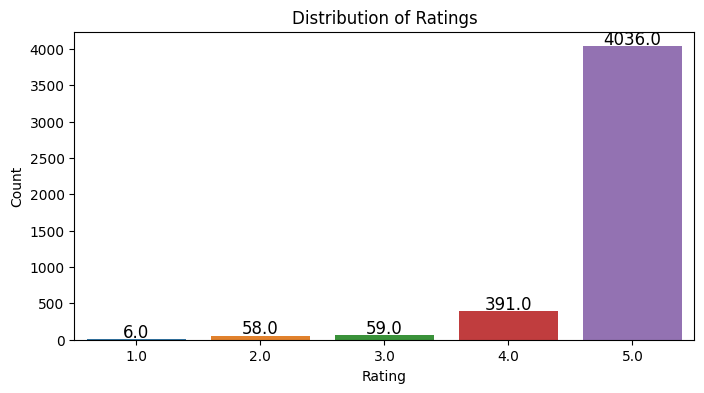

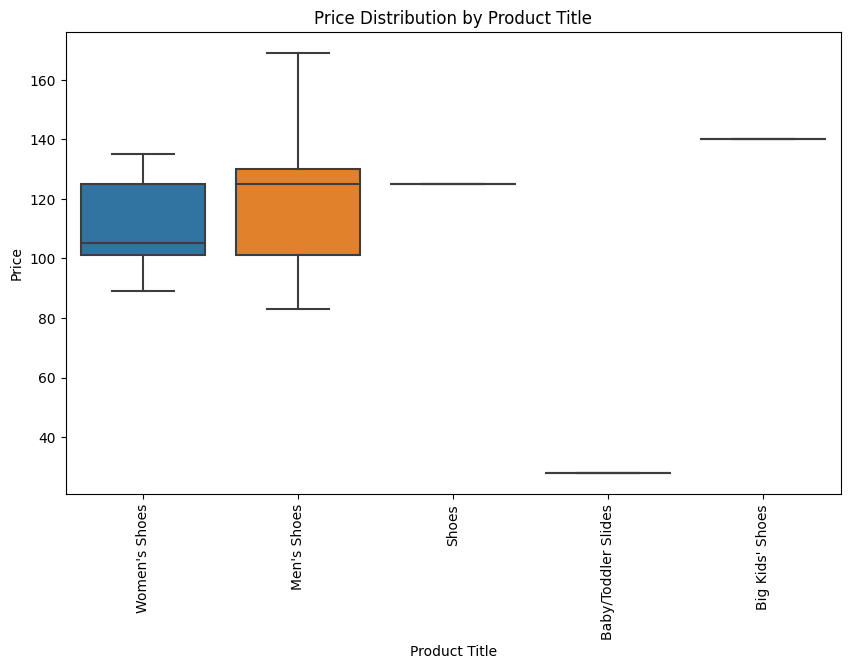

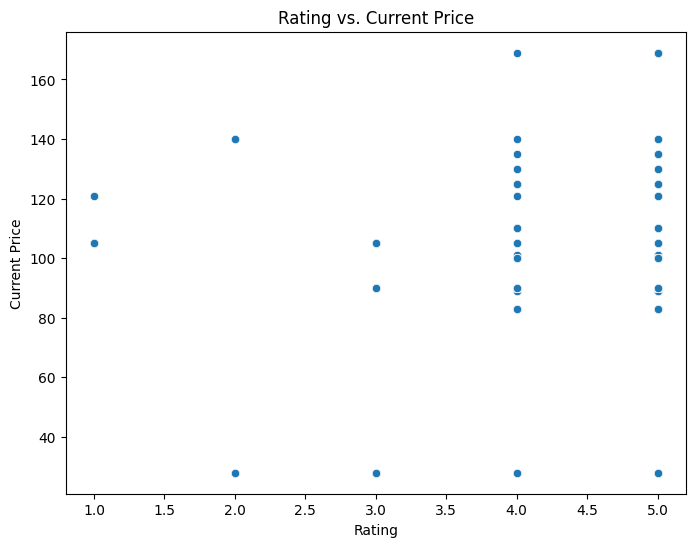

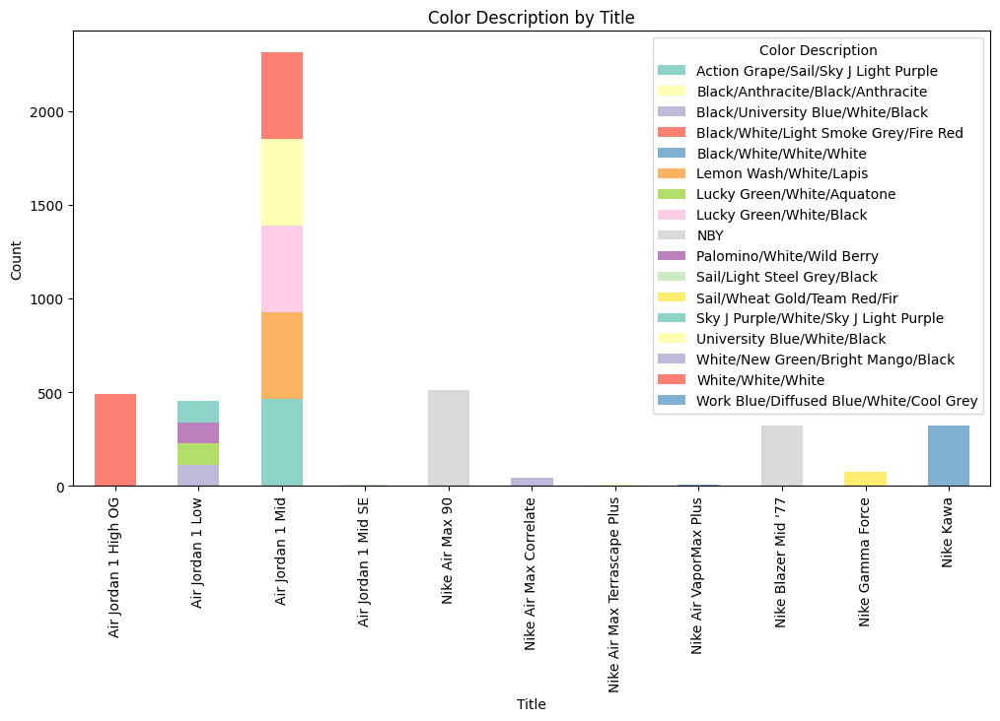

In [5]:
plt.figure(figsize = (8, 4))
sns.histplot(Nike["currentPrice"], bins = 20, kde = True, color = "red")
plt.title("Distribution of Current Prices")
plt.xlabel("Price")
plt.ylabel("Count")
plt.show()

plt.figure(figsize=(8, 4))
ax = sns.countplot(x="Rating", data=Nike)
plt.title("Distribution of Ratings")
plt.xlabel("Rating")
plt.ylabel("Count")

for p in ax.patches:
    ax.annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2., p.get_height()),
                ha='center', va='center', fontsize=12, color='black', xytext=(0, 5),
                textcoords='offset points')

plt.show()

plt.figure(figsize = (10, 6))
sns.boxplot(x = "subtitle", y = "currentPrice", data = Nike)
plt.xticks(rotation=90)
plt.title("Price Distribution by Product Title")
plt.xlabel("Product Title")
plt.ylabel("Price")
plt.show()

plt.figure(figsize = (8, 6))
sns.scatterplot(x = "Rating", y = "currentPrice", data = Nike)
plt.title("Rating vs. Current Price")
plt.xlabel("Rating")
plt.ylabel("Current Price")
plt.show()


colors = sns.color_palette("Set3")

pivot_table = Nike.pivot_table(index = 'title', columns = 'colorDescription', aggfunc = 'size', fill_value = 0)
pivot_table.plot(kind = 'bar', stacked = True, figsize = (12, 6), color = colors)
plt.title('Color Description by Title')
plt.xlabel('Title')
plt.ylabel('Count')
plt.xticks(rotation=90)
plt.legend(title='Color Description')
plt.show()

**HeatMap**

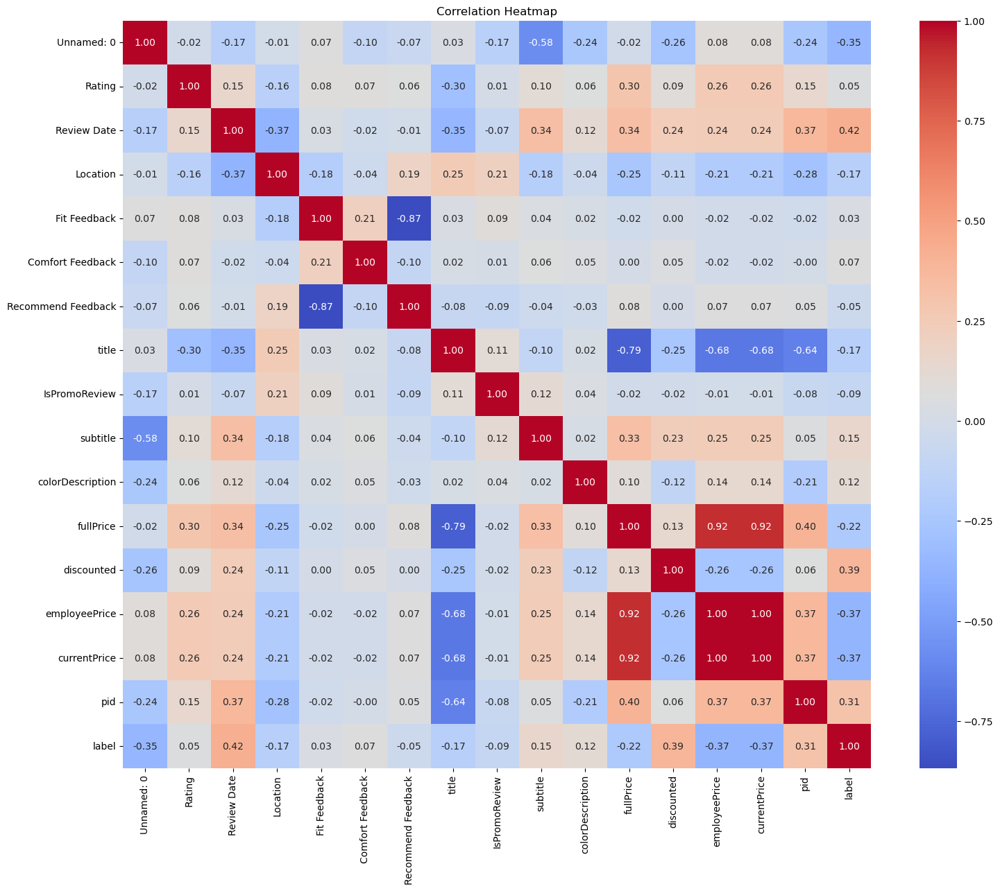

In [4]:
label_encoder = LabelEncoder()
categorical_columns = ["Review Date", "Location", "Fit Feedback", "Comfort Feedback", "Recommend Feedback", 
                       "title", "subtitle", "colorDescription", "discounted", "pid", "label"]
for column in categorical_columns:
    Nike[column] = label_encoder.fit_transform(Nike[column])

correlation_matrix = Nike.corr()
plt.figure(figsize = (18,14))
sns.heatmap(correlation_matrix, annot = True, cmap = "coolwarm", fmt = ".2f", square = True)
plt.title("Correlation Heatmap")
plt.show()

**Train Data / Test Data**

In [5]:
X_C = Nike.drop("Rating", axis = 1)
y_C = Nike["Rating"]
X_train_C, X_test_C, y_train_C, y_test_C = train_test_split(X_C, y_C, test_size = 0.2, random_state = 42)

X_R = Nike.drop(columns = ["fullPrice", "employeePrice", "currentPrice"], axis = 1)
y_R = Nike["currentPrice"]
X_train_R, X_test_R, y_train_R, y_test_R = train_test_split(X_R, y_R, test_size = 0.2, random_state = 42)

**Linear Regression Model**

Linear Regression Model:
Mean Squared Error: 86.96
R-squared: 0.88


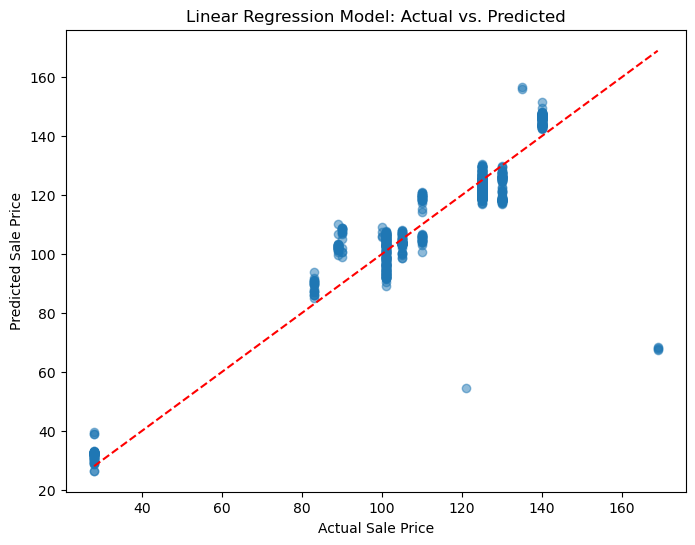

In [6]:
lr_model = LinearRegression()
lr_model.fit(X_train_R, y_train_R)

lr_predictions = lr_model.predict(X_test_R)

lr_mse = mean_squared_error(y_test_R, lr_predictions).round(2)
lr_r2 = r2_score(y_test_R, lr_predictions).round(2)

print("Linear Regression Model:")
print("Mean Squared Error:", lr_mse)
print("R-squared:", lr_r2)

plt.figure(figsize = (8, 6))
plt.scatter(y_test_R, lr_predictions, alpha = 0.5)
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("Linear Regression Model: Actual vs. Predicted")
plt.plot([min(y_test_R), max(y_test_R)], [min(y_test_R), max(y_test_R)], color = "red", linestyle = "--")
plt.show()

**Decision Tree Model**

In [7]:
param_grid = {
    'max_depth': [5, 10, 15],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(estimator = DecisionTreeClassifier(), param_grid = param_grid, cv=5)
grid_search.fit(X_train_C, y_train_C)
best_params = grid_search.best_params_

treemodel = DecisionTreeClassifier(**best_params)
treemodel.fit(X_train_C, y_train_C)
plt.figure(figsize = (200,100))
plot_tree(treemodel, feature_names = X_C.columns.tolist(), class_names = ["5","4","3","2","1"], 
          filled = True, rounded = True, fontsize = 14)

y_pred_C = treemodel.predict(X_test_C)

dt_mse = mean_squared_error(y_test_C, y_pred_C).round(3)
dt_r2 = r2_score(y_test_C, y_pred_C).round(3)
class_report = classification_report(y_test_C, y_pred_C)

print("Decision Tree Classifier Model:")
print("Best Decision Tree Hyperparameter:", best_params)
print("Classification Report:\n", class_report)

print("Mean Squared Error:", dt_mse)
print("R-squared:", dt_r2)

print("Accuracy Value:", accuracy_score(y_test_C, y_pred_C).round(3))

Decision Tree Classifier Model:
Best Decision Tree Hyperparameter: {'max_depth': 15, 'min_samples_leaf': 1, 'min_samples_split': 2}
Classification Report:
               precision    recall  f1-score   support

         2.0       1.00      1.00      1.00        16
         3.0       0.38      0.38      0.38         8
         4.0       0.78      0.85      0.82        75
         5.0       0.99      0.98      0.98       811

    accuracy                           0.96       910
   macro avg       0.79      0.80      0.79       910
weighted avg       0.96      0.96      0.96       910

Mean Squared Error: 0.058
R-squared: 0.769
Accuracy Value: 0.962


Best Decision Tree Parameters: {'max_depth': 10, 'min_samples_leaf': 4, 'min_samples_split': 5}
Decision Tree Regression Model:
Mean Squared Error: 2.057
R-squared: 0.997


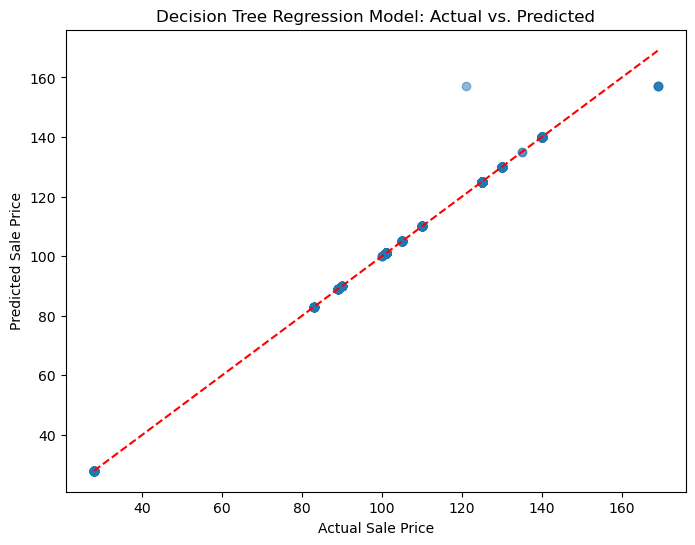

In [8]:
mse_scorer = make_scorer(mean_squared_error)
tree_param_grid = {
    'max_depth': [10, 20, 30],  
    'min_samples_split': [2, 5, 10],  
    'min_samples_leaf': [1, 2, 4] 
}

tree_grid_search = GridSearchCV(estimator=DecisionTreeRegressor(), param_grid=tree_param_grid, cv=5, scoring=mse_scorer)
tree_grid_search.fit(X_train_R, y_train_R)

best_tree_params = tree_grid_search.best_params_

print("Best Decision Tree Parameters:", best_tree_params)

dt_model = DecisionTreeRegressor(**best_tree_params)
dt_model.fit(X_train_R, y_train_R)

dt_predictions = dt_model.predict(X_test_R)

dt_mse = mean_squared_error(y_test_R, dt_predictions).round(3)
dt_r2 = r2_score(y_test_R, dt_predictions).round(3)

print("Decision Tree Regression Model:")
print("Mean Squared Error:", dt_mse)
print("R-squared:", dt_r2)

fig, ax = plt.subplots(figsize = (20, 20), dpi = 500)
tree.plot_tree(dt_model, filled = True, feature_names = X_train_R.columns)
plt.show()

plt.figure(figsize = (8, 6))
plt.scatter(y_test_R, dt_predictions, alpha = 0.5)
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("Decision Tree Regression Model: Actual vs. Predicted")
plt.plot([min(y_test_R), max(y_test_R)], [min(y_test_R), max(y_test_R)], color = 'red', linestyle = '--')
plt.show()

**Random Forest model**

In [9]:
param_grid = {
    'n_estimators': [50, 100, 200],  
    'max_depth': [10, 20, 30],  
    'min_samples_split': [2, 5, 10], 
    'min_samples_leaf': [1, 2, 4]  
}

grid_search = GridSearchCV(estimator = RandomForestClassifier(), param_grid = param_grid, cv = 5, scoring = "accuracy")
grid_search.fit(X_train_C, y_train_C)
best_rf_params = grid_search.best_params_

rfclass = RandomForestClassifier(**best_rf_params)
rfclass.fit(X_train_C, y_train_C)
rfpred = rfclass.predict(X_test_C)
rfclass.score(X_test_C, y_test_C)

tree_to_plot = 0 
estimator = rfclass.estimators_[tree_to_plot]

rf_mse = mean_squared_error(y_test_C, rfpred).round(3)
rf_r2 = r2_score(y_test_C, rfpred).round(3)

class_report = classification_report(y_test_C, rfpred)

print("Random Forest Classifier Model:")
print("Best Random Forest Parameters:", best_rf_params)
print("Classification Report:\n", class_report)

print("Mean Squared Error:", rf_mse)
print("R-squared:", rf_r2)
print("Accuracy Value:", accuracy_score(y_test_C, rfpred).round(3))
, dpi = 2000
fig, ax = plt.subplots(figsize = (12, 12), dpi = 1500)
tree.plot_tree(estimator, filled = True, feature_names = X_train_C.columns)
plt.show()

Random Forest Classifier Model:
Best Random Forest Parameters: {'max_depth': 10, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 50}
Classification Report:
               precision    recall  f1-score   support

         2.0       1.00      0.62      0.77        16
         3.0       1.00      0.38      0.55         8
         4.0       1.00      0.59      0.74        75
         5.0       0.95      1.00      0.97       811

    accuracy                           0.95       910
   macro avg       0.99      0.65      0.76       910
weighted avg       0.96      0.95      0.95       910

Mean Squared Error: 0.115
R-squared: 0.543
Accuracy Value: 0.954


Random Forest Regression Model:
Best Random Forest Parameters: {'max_depth': 20, 'min_samples_leaf': 4, 'min_samples_split': 5, 'n_estimators': 50}
Mean Squared Error: 3.926
R-squared: 0.995


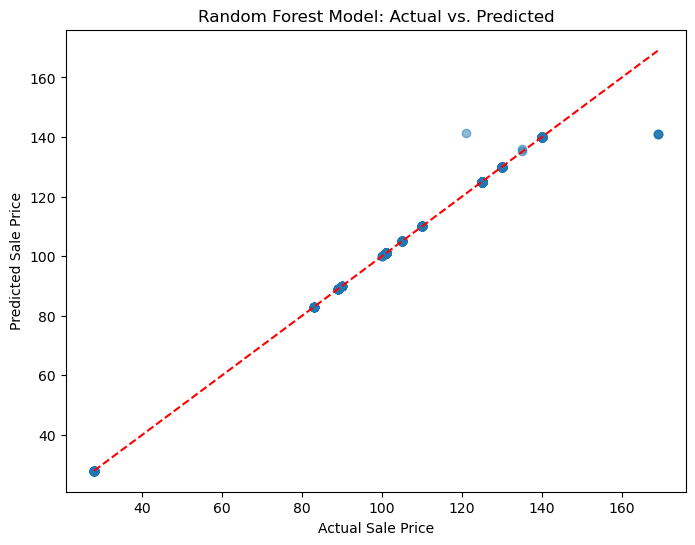

In [10]:
rf_param_grid = {
    'n_estimators': [50, 100, 200],  
    'max_depth': [10, 20, 30], 
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]  
}

rf_grid_search = GridSearchCV(estimator=RandomForestRegressor(), param_grid=rf_param_grid, cv=5, scoring=mse_scorer)
rf_grid_search.fit(X_train_R, y_train_R)
best_rf_params = rf_grid_search.best_params_

rf_model = RandomForestRegressor(**best_rf_params)
rf_model.fit(X_train_R, y_train_R)

rf_predictions = rf_model.predict(X_test_R)

rf_mse = mean_squared_error(y_test_R, rf_predictions).round(3)
rf_r2 = r2_score(y_test_R, rf_predictions).round(3)

print("Random Forest Regression Model:")
print("Best Random Forest Parameters:", best_rf_params)
print("Mean Squared Error:", rf_mse)
print("R-squared:", rf_r2)

estimator_R = rfclass.estimators_[tree_to_plot]
fig, ax = plt.subplots(figsize=(12, 12), dpi = 2000)
tree.plot_tree(estimator_R, filled=True, feature_names=X_train_C.columns)
plt.show()

plt.figure(figsize = (8, 6))
plt.scatter(y_test_R, rf_predictions, alpha = 0.5)
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("Random Forest Model: Actual vs. Predicted")
plt.plot([min(y_test_R), max(y_test_R)], [min(y_test_R), max(y_test_R)], color = 'red', linestyle = '--')
plt.show()

**Gradient Boost model**

Best Gradient Boosting Classifier Model:
Best Hyper parameters: {'learning_rate': 0.2, 'max_depth': 3, 'n_estimators': 200}
Classification Report:
               precision    recall  f1-score   support

         2.0       1.00      1.00      1.00        16
         3.0       0.43      0.38      0.40         8
         4.0       0.85      0.84      0.85        75
         5.0       0.98      0.99      0.99       811

    accuracy                           0.97       910
   macro avg       0.82      0.80      0.81       910
weighted avg       0.97      0.97      0.97       910

Mean Squared Error: 0.047
Accuracy: 0.969
R-squared: 0.813


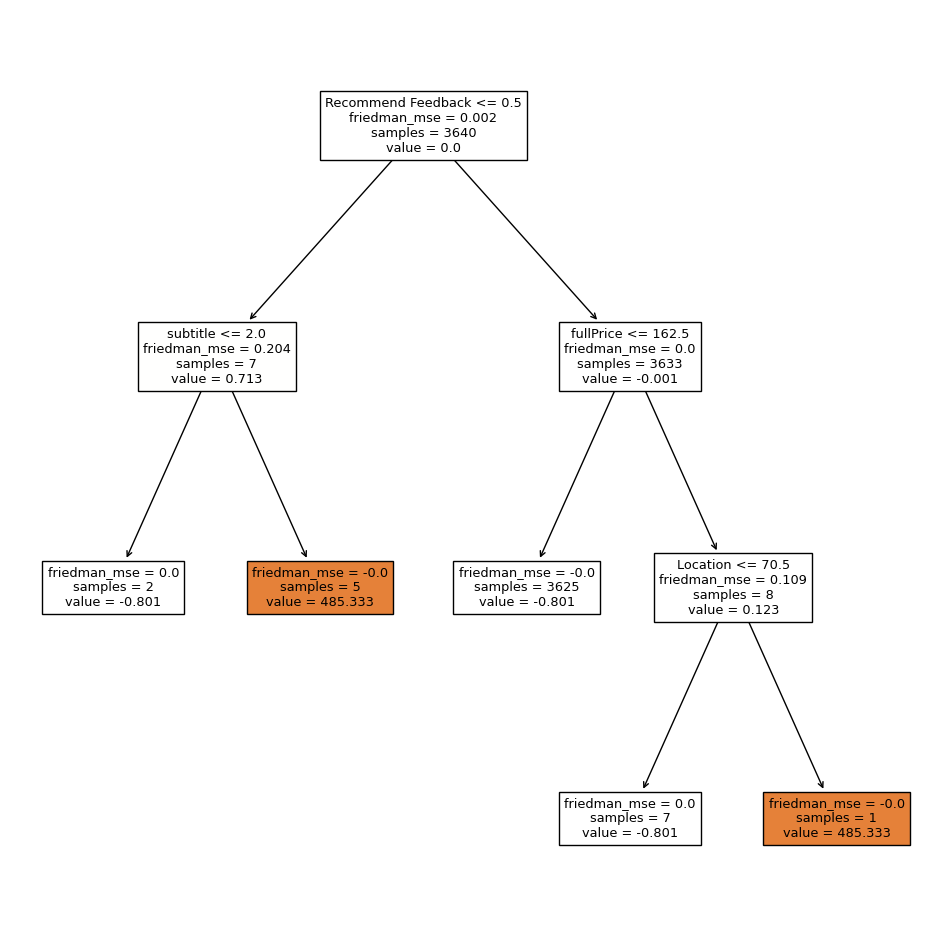

In [14]:
gb_model_C = GradientBoostingClassifier(random_state = 42)

param_grid = {
    'n_estimators': [100, 200, 300], 
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5]  
}

grid_search = GridSearchCV(estimator = gb_model_C, param_grid = param_grid, cv = 5, scoring = 'neg_mean_squared_error')
grid_search.fit(X_train_C, y_train_C)
best_params_C = grid_search.best_params_


best_gb_classifier = GradientBoostingClassifier(random_state = 42, **best_params_C)
best_gb_classifier.fit(X_train_C, y_train_C)

best_gb_classifier_predictions = best_gb_classifier.predict(X_test_C)
best_gb_r2_class = r2_score(y_test_C, best_gb_classifier_predictions).round(3)

accuracy = accuracy_score(y_test_C, best_gb_classifier_predictions).round(3)
best_gb_mse = mean_squared_error(y_test_C, best_gb_classifier_predictions).round(3)

class_report = classification_report(y_test_C, best_gb_classifier_predictions)

print("Best Gradient Boosting Classifier Model:")
print("Best Hyper parameters:", best_params_C)
print("Classification Report:\n", class_report)
print("Mean Squared Error:", best_gb_mse)
print("Accuracy:", accuracy)
print("R-squared:", best_gb_r2_class)

fig, ax = plt.subplots(figsize=(12, 12))
tree.plot_tree(best_gb_classifier.estimators_[0, 0], filled=True, feature_names=X_train_C.columns)
plt.show()

Best Hyper parameters: {'learning_rate': 0.1, 'max_depth': 4, 'n_estimators': 300}
Best Gradient Boosting Regressor Model:
Mean Squared Error: 0.002
R-squared: 1.0


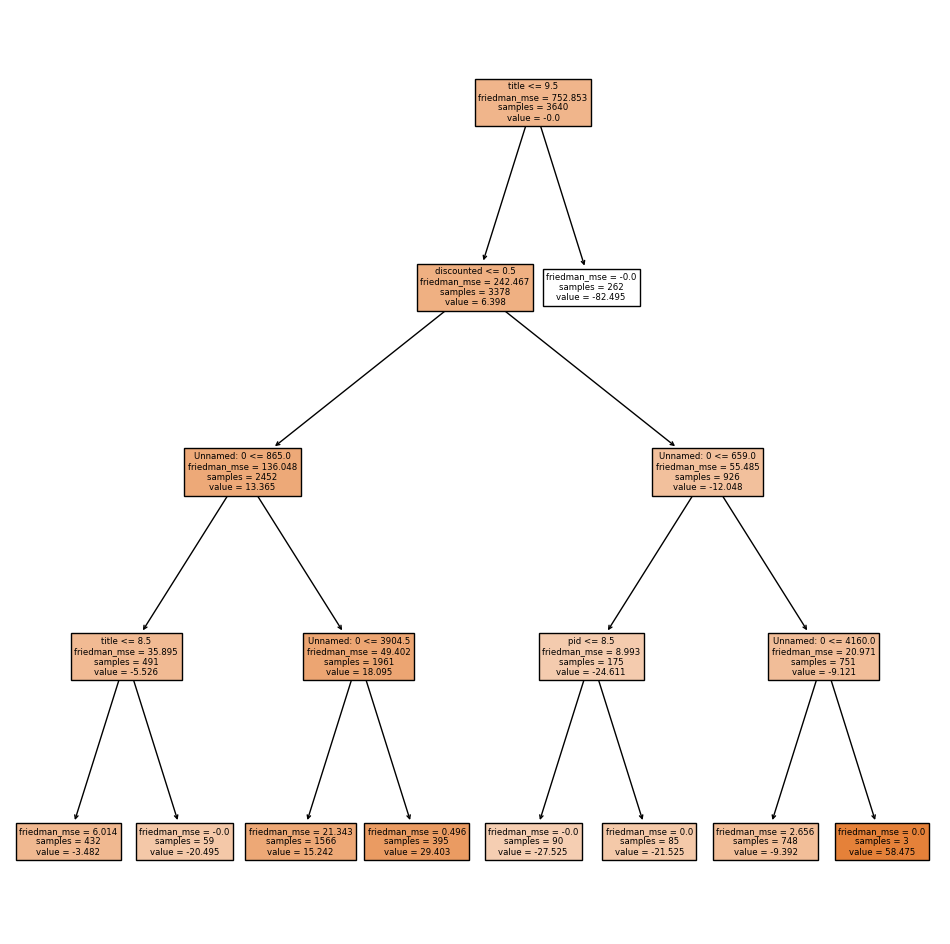

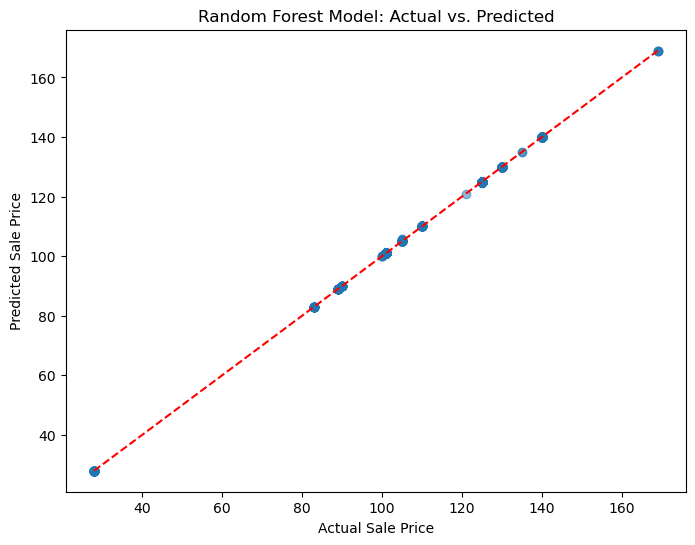

In [12]:
gb_model = GradientBoostingRegressor(random_state = 42)

param_grid = {
    'n_estimators': [100, 200, 300], 
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 4, 5]  
}

grid_search = GridSearchCV(estimator = gb_model, param_grid = param_grid, cv = 5, scoring = 'neg_mean_squared_error')
grid_search.fit(X_train_R, y_train_R)
best_params = grid_search.best_params_
print("Best Hyper parameters:", best_params)

best_gb_model = GradientBoostingRegressor(random_state=42, **best_params)
best_gb_model.fit(X_train_R, y_train_R)
best_gb_predictions = best_gb_model.predict(X_test_R)

best_gb_mse = mean_squared_error(y_test_R, best_gb_predictions).round(3)
best_gb_r2 = r2_score(y_test_R, best_gb_predictions).round(3)

print("Best Gradient Boosting Regressor Model:")
print("Mean Squared Error:", best_gb_mse)
print("R-squared:", best_gb_r2)

fig, ax = plt.subplots(figsize = (12, 12))
tree.plot_tree(best_gb_model.estimators_[0, 0], filled = True, feature_names = X_train_R.columns)
plt.show()

plt.figure(figsize = (8, 6))
plt.scatter(y_test_R, best_gb_predictions, alpha = 0.5)
plt.xlabel("Actual Sale Price")
plt.ylabel("Predicted Sale Price")
plt.title("Random Forest Model: Actual vs. Predicted")
plt.plot([min(y_test_R), max(y_test_R)], [min(y_test_R), max(y_test_R)], color = 'red', linestyle = '--')
plt.show()